In [1]:
import circuitsvis as cv
import numpy as np
import torch
from taker import Model
from taker.hooks import HookConfig
from datetime import datetime
import json
from os import listdir
from os.path import exists

import numpy as np
import pandas as pd
from sentence_transformers import SentenceTransformer
from sklearn.decomposition import PCA, TruncatedSVD
from sklearn.manifold import TSNE
import torch

import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

/workspace/SPAR/interp-ab/.venv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
m = Model("google/gemma-2-9b-it")
m.show_details()

Loading checkpoint shards: 100%|██████████| 4/4 [00:07<00:00,  1.88s/it]


Loaded model 'google/gemma-2-9b-it' with bfp16:
- Added 672 hooks across 42 layers
 - n_layers : 42
 - d_model  : 3584
 - n_heads  : 16
 - d_head   : 256
 - d_mlp    : 14336


In [2]:
filepath = "../gemma9b_results/latest_transferred_generation.jsonl"
results_df = pd.read_json(filepath, lines=True)
baselinefile = "../gemma9b_results/latest_orig_generation_new.jsonl"
base_df = pd.read_json(baselinefile, lines=True)
neutralfile0 = "../gemma9b_results/latest_neutral0_generation.jsonl"
neutral_df0 = pd.read_json(neutralfile0, lines=True)
neutralfile1 = "../gemma9b_results/latest_neutral1_generation.jsonl"
neutral_df1 = pd.read_json(neutralfile1, lines=True)
neutralfile2 = "../gemma9b_results/latest_neutral2_generation.jsonl"
neutral_df2 = pd.read_json(neutralfile2, lines=True)
neutralfile3 = "../gemma9b_results/latest_neutral3_generation.jsonl"
neutral_df3 = pd.read_json(neutralfile3, lines=True)
neutralfile4 = "../gemma9b_results/latest_neutral4_generation.jsonl"
neutral_df4 = pd.read_json(neutralfile4, lines=True)
neutralfile5 = "../gemma9b_results/latest_neutral5_generation.jsonl"
neutral_df5 = pd.read_json(neutralfile5, lines=True)
neutralfile10 = "../gemma9b_results/latest_neutral10_generation.jsonl"
neutral_df10 = pd.read_json(neutralfile10, lines=True)
neutralfile15 = "../gemma9b_results/latest_neutral15_generation.jsonl"
neutral_df15 = pd.read_json(neutralfile15, lines=True)
neutralfile20 = "../gemma9b_results/latest_neutral20_generation.jsonl"
neutral_df20 = pd.read_json(neutralfile20, lines=True)
neutralfile25 = "../gemma9b_results/latest_neutral25_generation.jsonl"
neutral_df25 = pd.read_json(neutralfile25, lines=True)
allneutrals = [neutral_df0, neutral_df1, neutral_df2, neutral_df3, neutral_df4, neutral_df5, neutral_df10, neutral_df15, neutral_df20, neutral_df25]
neutral_dflist = pd.concat(allneutrals, ignore_index=True, sort=False)
def split_at_double_newline(text):
    # Ensure we are only working with strings longer than 15 characters
    if len(text) > 15:
        # Search for the first double newline after the 5th character
        pos = text.find('\n\n', 5)
        if pos != -1:  # Check if double newline was found
            return text[:pos], text[pos+2:]  # Split and remove the newline from the second part
        print("none")
    return None, text  # If no split is required, return the original text and None
_ , base_df['para2'] = zip(*base_df['output'].apply(split_at_double_newline))
base_df['output'] = base_df['para2'].copy()
neutral_dflist['output'] = neutral_dflist['prompt'].str[2:] + neutral_dflist['output'] #need to do this with the string
total_df = pd.concat([results_df, base_df, neutral_dflist], ignore_index=True, sort=False)
total_df["init_prompt"] = total_df['orig_prompt'].where(total_df['prompt'].isna(), total_df['prompt'])
for j in range(2000, 2000+len(allneutrals*1000), 1000):
    for i in range(1000):
        var = int(j+i)
        total_df["output"][var] = total_df["output"][var][:len(total_df["output"][i])]
        total_df["output"][var] = total_df["output"][var][:len(total_df["output"][i])]
total_df["cheat_tokens"] = total_df["cheat_tokens"].fillna(-1)
total_df["cheat_tokens"] = total_df["cheat_tokens"].astype(int)
total_df["cheat_tokens"] = total_df["cheat_tokens"].astype(str)
total_df["cheat_tokens"] = total_df["cheat_tokens"].replace('-1', np.nan)
total_df["type-extended"] = total_df['type'].where(total_df['type']!="neutral", "neutral"+total_df['cheat_tokens'])
print(total_df.columns)
print(total_df['type-extended'][10000])
print(total_df['type'][10000])
print(total_df['cheat_tokens'][10000])
print(total_df['output'][0])
print(total_df['output'][1000])
print(total_df['output'][10000])
print(repr(total_df['init_prompt'][2000]))

Index(['temperature', 'max_new_tokens', 'model', 'type',
       'num_transferred_tokens', 'transplant_layers', 'orig_prompt',
       'transplant_prompt', 'output', 'prompt', 'para2', 'cheat_tokens',
       'init_prompt', 'type-extended'],
      dtype='object')
neutral20
neutral
20
The world is a symphony of sounds, each one a story waiting to be told. The gentle rustle of leaves, the rhythmic crashing of waves, the melodic chirping of birds - all these sounds weave together to create a tapestry of life. But amidst this harmonious chorus, there are also sounds that can pierce the soul, sounds that carry with them the weight of pain, loss, and sorrow. These are the sounds of silence, the sounds that speak volumes when words fail. 

The world seemed to fade away as I stepped away from the constant buzz of notifications and the endless scroll.  Silence, once a rarity, became a comforting presence.  I rediscovered the joy of reading a physical book, the pages turning slowly, each word savor

/tmp/ipykernel_933659/3954816310.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  total_df["output"][var] = total_df["output"][var][:len(total_df["output"][i])]
/tmp/ipykernel_933659/3954816310.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  total_df["output"][var] = total_df["output"][var][:len(total_df["output"][i])]


In [3]:
sentenceTransformer = SentenceTransformer("all-mpnet-base-v2")

embeddings = sentenceTransformer.encode(total_df['output'].to_list())
print(embeddings.shape)
total_df["embeddings"] = embeddings.tolist()
from sklearn.preprocessing import StandardScaler
scaled_embeddings = StandardScaler().fit_transform(embeddings)
neutral_start = results_df.shape[0]+base_df.shape[0]
results_df["embeddings"] = embeddings[:1000].tolist()
base_df["embeddings"] = embeddings[1000:2000].tolist()
neutral_df0["embeddings"] = embeddings[2000:3000].tolist()
neutral_df1["embeddings"] = embeddings[3000:4000].tolist()
neutral_df2["embeddings"] = embeddings[4000:5000].tolist()
neutral_df3["embeddings"] = embeddings[5000:6000].tolist()
neutral_df4["embeddings"] = embeddings[6000:7000].tolist()
neutral_df5["embeddings"] = embeddings[7000:8000].tolist()
neutral_df10["embeddings"] = embeddings[8000:9000].tolist()
neutral_df15["embeddings"] = embeddings[9000:10000].tolist()
neutral_df20["embeddings"] = embeddings[10000:11000].tolist()
neutral_df25["embeddings"] = embeddings[11000:12000].tolist()
results_df["scaled_embeddings"] = scaled_embeddings[:1000].tolist()
base_df["scaled_embeddings"] = scaled_embeddings[1000:2000].tolist()
neutral_df0["scaled_embeddings"] = scaled_embeddings[2000:3000].tolist()
neutral_df1["scaled_embeddings"] = scaled_embeddings[3000:4000].tolist()
neutral_df2["scaled_embeddings"] = scaled_embeddings[4000:5000].tolist()
neutral_df3["scaled_embeddings"] = scaled_embeddings[5000:6000].tolist()
neutral_df4["scaled_embeddings"] = scaled_embeddings[6000:7000].tolist()
neutral_df5["scaled_embeddings"] = scaled_embeddings[7000:8000].tolist()
neutral_df10["scaled_embeddings"] = scaled_embeddings[8000:9000].tolist()
neutral_df15["scaled_embeddings"] = scaled_embeddings[9000:10000].tolist()
neutral_df20["scaled_embeddings"] = scaled_embeddings[10000:11000].tolist()
neutral_df25["scaled_embeddings"] = scaled_embeddings[11000:12000].tolist()
results_df.head()
print(results_df.shape)
print(base_df.shape)
#takes a couple mins

(12000, 768)
(1000, 11)
(1000, 10)


# PCA

In [4]:

# carry out pca on embeddings using sklearn
reducer = PCA(n_components=2)
pca_embeddings_reduced = reducer.fit_transform(embeddings)
print(pca_embeddings_reduced.shape)

# visualize the embeddings using plotly
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

total_df["pcadim1"] = pca_embeddings_reduced[:, 0]
total_df["pcadim2"] = pca_embeddings_reduced[:, 1]

total_df["truncated_output"] = total_df["output"].str.slice(0,25)

fig = px.scatter(
    total_df,
    x="pcadim1",
    y="pcadim2",
    hover_data=["type-extended", "init_prompt", "transplant_prompt", "truncated_output"],
    title="PCA of Story Embeddings",
    color="type-extended",
    # category_orders={"type":["neutral","original","transferred"]}

)

# fig.update_layout(coloraxis_colorbar=dict(yanchor="top", y=1, x=100, xref="container"))

fig.update_traces(
    hovertemplate="<br>".join(
        ["Type: %{customdata[0]}", "Orig Prompt: %{customdata[1]}", "Transplanted Prompt: %{customdata[2]}", "Output: %{customdata[3]}"]
    )
)


fig.show()

(12000, 2)


In [58]:
pca_df = pd.DataFrame(pca_embeddings_reduced, columns=['PC1', 'PC2'])
print(pca_df.head())
pca_df['type-extended'] = total_df['type-extended']

mean_pca_df = pca_df.groupby(['type-extended']).mean().reset_index()
print(mean_pca_df.head())

# fig.add_trace(px.scatter(mean_pca_df, x='PC1', y='PC2', color='temperature', symbol='layers_string',
#                          title='Means of PCA Groups').data[0]):
mean_pca_df['plot'] = 'Mean'
pca_df['plot'] = 'Original'
combined_df = pd.concat([pca_df, mean_pca_df], ignore_index=True)
# fig = px.scatter(combined_df, x='PC1', y='PC2', color='temperature', symbol='layers_string', title='PCA of Sentence Embeddings')

# Plot mean points
mean_fig = px.scatter(mean_pca_df, x='PC1', y='PC2', color='type-extended', title='Means of PCA Groups')
mean_fig.update_yaxes(range=[-0.3, 0.3])

mean_fig.show()

        PC1       PC2
0 -0.158235  0.386228
1  0.006103  0.267741
2 -0.084663  0.244838
3 -0.096637  0.336382
4 -0.095034  0.172225
  type-extended       PC1       PC2
0      neutral0 -0.513368 -0.285326
1      neutral1 -0.066765 -0.059159
2     neutral10  0.061212  0.039171
3     neutral15  0.064592  0.036952
4      neutral2  0.045554  0.005316


# TSNE

In [7]:
# reducer = PCA(n_components=50)
# embeddings_reduced = reducer.fit_transform(embeddings)

In [5]:
!pip install kaleido

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [7]:

reducer = TSNE(n_components=2)
tsne_embeddings_reduced = reducer.fit_transform(embeddings)
print(tsne_embeddings_reduced.shape)


total_df["tsnedim1"] = tsne_embeddings_reduced[:, 0]
total_df["tsnedim2"] = tsne_embeddings_reduced[:, 1]

total_df["truncated_output"] = total_df["output"].str.slice(0,25)
mini_df = total_df[
    (total_df["type-extended"] == "transferred") |
    (total_df["type-extended"] == "original") |
    (total_df["type-extended"] == "neutral0")
]
print(mini_df.head())

fig = px.scatter(
    mini_df,
    x="tsnedim1",
    y="tsnedim2",
    labels={
            "tsnedim1": "dim1",
            "tsnedim2": "dim2"
            },
    hover_data=["type-extended", "init_prompt", "transplant_prompt", "truncated_output"],
    color="type-extended",

    # category_orders={"type":["neutral","original","transferred"]}

)

# fig.update_layout(coloraxis_colorbar=dict(yanchor="top", y=1, x=100, xref="container"))

fig.update_traces(
    hovertemplate="<br>".join(
        ["Type: %{customdata[0]}", "Orig Prompt: %{customdata[1]}", "Transplanted Prompt: %{customdata[2]}", "Output: %{customdata[3]}"]
    )
)

fig.update_layout(margin=dict(l=0, r=0, t=0, b=0), font_size=16)
fig.show()
pio.write_image(fig, "tsnehighresallneutral.png", format="png", width = 750, height= 450, scale=4)


(12000, 2)
   temperature  max_new_tokens                 model         type  \
0          0.3             200  google/gemma-2-9b-it  transferred   
1          0.3             200  google/gemma-2-9b-it  transferred   
2          0.3             200  google/gemma-2-9b-it  transferred   
3          0.3             200  google/gemma-2-9b-it  transferred   
4          0.3             200  google/gemma-2-9b-it  transferred   

   num_transferred_tokens transplant_layers  \
0                     1.0           [0, 42]   
1                     1.0           [0, 42]   
2                     1.0           [0, 42]   
3                     1.0           [0, 42]   
4                     1.0           [0, 42]   

                                         orig_prompt transplant_prompt  \
0  Tell me about a weekend in a mountain cabin in...              \n\n   
1  Tell me about a weekend in a mountain cabin in...              \n\n   
2  Tell me about a weekend in a mountain cabin in...              \n\

In [18]:
fig.update_layout(font_size=24)
fig.update_layout(legend= {'itemsizing': 'constant'})
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    entrywidth=0,
    yanchor="bottom",
    y=-0.35,
    xanchor="right",
    x=0.85
))
fig.show()
pio.write_image(fig, "tsnehighres.png", format="png", width = 750, height= 450, scale=4)

# PHATE

In [23]:
import phate
phate_op = phate.PHATE(knn=5, decay=5)
# phate_op = phate.PHATE()
data_phate = phate_op.fit_transform(embeddings)

total_df["phatedim1"] = data_phate[:, 0]
total_df["phatedim2"] = data_phate[:, 1]


total_df["truncated_output"] = total_df["output"].str.slice(0,50)
mini_df = total_df[
    (total_df["type-extended"] == "transferred") |
    (total_df["type-extended"] == "original") |
    (total_df["type-extended"] == "neutral0") |
    (total_df["type-extended"] == "neutral1") |
    (total_df["type-extended"] == "neutral2")
]

fig = px.scatter(
    mini_df,
    x="phatedim1",
    y="phatedim2",
    hover_data=["type-extended", "init_prompt", "transplant_prompt", "truncated_output"],
    # title="PHATE of Story Embeddings",
    color="type-extended",
    # category_orders={"type":["neutral","original","transferred"]}

)

# fig.update_layout(coloraxis_colorbar=dict(yanchor="top", y=1, x=100, xref="container"))

fig.update_traces(
    hovertemplate="<br>".join(
        ["Type: %{customdata[0]}", "Orig Prompt: %{customdata[1]}", "Transplanted Prompt: %{customdata[2]}", "Output: %{customdata[3]}"]
    )
)

fig.update_layout(font_size=24)
fig.update_layout(legend= {'itemsizing': 'constant'})
# set legend title to "Type"
fig.update_layout(legend_title="Type")
# fig.show()
pio.write_image(fig, "phate-highres-2.png", format="png", width = 750, height= 450, scale=4)
fig.show()

Calculating PHATE...
  Running PHATE on 12000 observations and 768 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 1.44 seconds.
    Calculating KNN search...
    Calculated KNN search in 4.78 seconds.
    Calculating affinities...


/workspace/SPAR/interp-ab/.venv/lib/python3.10/site-packages/graphtools/graphs.py:290: RuntimeWarning:

Detected zero distance between 56 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.



    Calculated affinities in 6.18 seconds.
  Calculated graph and diffusion operator in 12.54 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 4.00 seconds.
    Calculating KMeans...
    Calculated KMeans in 2.26 seconds.
  Calculated landmark operator in 9.42 seconds.
  Calculating optimal t...
    Automatically selected t = 17
  Calculated optimal t in 1.02 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.36 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 2.79 seconds.
Calculated PHATE in 26.15 seconds.


In [26]:

mini_df = total_df[
    (total_df["type-extended"] == "transferred") |
    (total_df["type-extended"] == "original") |
    (total_df["type-extended"] == "neutral0")
    # (total_df["type-extended"] == "neutral1") |
    # (total_df["type-extended"] == "neutral2")
]

fig = px.scatter(
    mini_df,
    x="phatedim1",
    y="phatedim2",
    hover_data=["type-extended", "init_prompt", "transplant_prompt", "truncated_output"],
    # title="PHATE of Story Embeddings",
    color="type-extended",
    # category_orders={"type":["neutral","original","transferred"]}

)

# fig.update_layout(coloraxis_colorbar=dict(yanchor="top", y=1, x=100, xref="container"))

fig.update_traces(
    hovertemplate="<br>".join(
        ["Type: %{customdata[0]}", "Orig Prompt: %{customdata[1]}", "Transplanted Prompt: %{customdata[2]}", "Output: %{customdata[3]}"]
    )
)

fig.update_layout(font_size=24)
fig.update_layout(legend= {'itemsizing': 'constant'})
# set legend title to "Type"
fig.update_layout(legend_title="Type")
# fig.show()
pio.write_image(fig, "phate-highres-0.png", format="png", width = 750, height= 450, scale=4)
fig.show()

In [16]:

phate_op = phate.PHATE(n_components=3)
data_phate = phate_op.fit_transform(embeddings)
total_df["phatedim1"] = data_phate[:, 0]
total_df["phatedim2"] = data_phate[:, 1]
total_df["phatedim3"] = data_phate[:, 2]


total_df["truncated_output"] = total_df["output"].str.slice(0,100)



fig = px.scatter_3d(
    total_df,
    x="phatedim1",
    y="phatedim2",
    z="phatedim3",
    hover_data=["type", "init_prompt", "transplant_prompt", "truncated_output"],
    title="PHATE of Story Embeddings",
    color="type",
    category_orders={"type":["neutral","original","transferred"]}

)

# fig.update_layout(coloraxis_colorbar=dict(yanchor="top", y=1, x=100, xref="container"))

fig.update_traces(
    hovertemplate="<br>".join(
        ["Type: %{customdata[0]}", "Orig Prompt: %{customdata[1]}", "Transplanted Prompt: %{customdata[2]}", "Output: %{customdata[3]}"]
    )
)


fig.show()

Calculating PHATE...
  Running PHATE on 12000 observations and 768 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.93 seconds.
    Calculating KNN search...
    Calculated KNN search in 4.79 seconds.
    Calculating affinities...
    Calculated affinities in 0.06 seconds.
  Calculated graph and diffusion operator in 5.79 seconds.
  Calculating landmark operator...
    Calculating SVD...


/workspace/SPAR/interp-ab/.venv/lib/python3.10/site-packages/graphtools/graphs.py:290: RuntimeWarning:

Detected zero distance between 56 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.



    Calculated SVD in 0.39 seconds.
    Calculating KMeans...
    Calculated KMeans in 3.23 seconds.
  Calculated landmark operator in 4.17 seconds.
  Calculating optimal t...
    Automatically selected t = 39
  Calculated optimal t in 0.93 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.67 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 34.74 seconds.
Calculated PHATE in 46.31 seconds.


# UMAP

In [29]:
import umap
from sklearn.preprocessing import StandardScaler
scaled_embeddings = StandardScaler().fit_transform(embeddings)
reducer = umap.UMAP()
umap_embeddings_reduced = reducer.fit_transform(scaled_embeddings)
print(umap_embeddings_reduced.shape)


total_df["umapdim1"] = umap_embeddings_reduced[:, 0]
total_df["umapdim2"] = umap_embeddings_reduced[:, 1]

total_df["truncated_output"] = total_df["output"].str.slice(0,25)

mini_df = total_df[
    (total_df["type-extended"] == "transferred") |
    (total_df["type-extended"] == "original") |
    (total_df["type-extended"] == "neutral0")
    | (total_df["type-extended"] == "neutral1")
    | (total_df["type-extended"] == "neutral2")
]
fig = px.scatter(
    mini_df,
    x="umapdim1",
    y="umapdim2",
    hover_data=["type-extended", "init_prompt", "transplant_prompt", "truncated_output"],
    # title="UMAP of Story Embeddings",
    color="type-extended",
    # category_orders={"type":["neutral","original","transferred"]}

)

# fig.update_layout(coloraxis_colorbar=dict(yanchor="top", y=1, x=100, xref="container"))

fig.update_traces(
    hovertemplate="<br>".join(
        ["Type: %{customdata[0]}", "Orig Prompt: %{customdata[1]}", "Transplanted Prompt: %{customdata[2]}", "Output: %{customdata[3]}"]
    )
)

# fig.data = (fig.data[1], fig.data[2], fig.data[0])
fig.update_layout(font_size=24)
fig.update_layout(legend= {'itemsizing': 'constant'})
fig.update_layout(legend_title="Type")
pio.write_image(fig, "umap-highres-2.png", format="png", width = 750, height= 450, scale=4)
fig.show()

(12000, 2)


In [31]:

mini_df = total_df[
    (total_df["type-extended"] == "transferred") |
    (total_df["type-extended"] == "original") |
    (total_df["type-extended"] == "neutral0")
    # | (total_df["type-extended"] == "neutral1")
    # | (total_df["type-extended"] == "neutral2")
]
fig = px.scatter(
    mini_df,
    x="umapdim1",
    y="umapdim2",
    hover_data=["type-extended", "init_prompt", "transplant_prompt", "truncated_output"],
    # title="UMAP of Story Embeddings",
    color="type-extended",
    # category_orders={"type":["neutral","original","transferred"]}

)

# fig.update_layout(coloraxis_colorbar=dict(yanchor="top", y=1, x=100, xref="container"))

fig.update_traces(
    hovertemplate="<br>".join(
        ["Type: %{customdata[0]}", "Orig Prompt: %{customdata[1]}", "Transplanted Prompt: %{customdata[2]}", "Output: %{customdata[3]}"]
    )
)

# fig.data = (fig.data[1], fig.data[2], fig.data[0])
fig.update_layout(font_size=24)
fig.update_layout(legend= {'itemsizing': 'constant'})
fig.update_layout(legend_title="Type")
pio.write_image(fig, "umap-highres-0.png", format="png", width = 750, height= 450, scale=4)
fig.show()

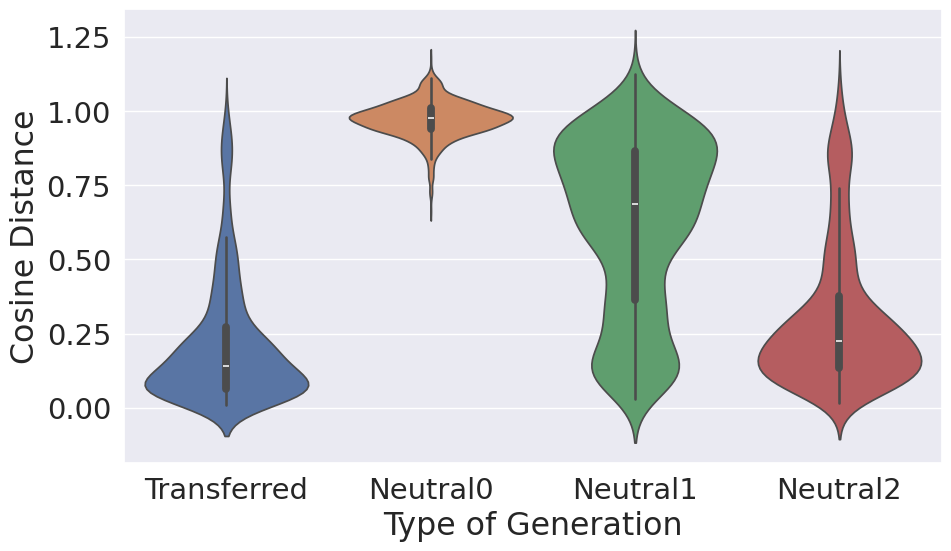

In [18]:
import pandas as pd
import torch
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_distances


df1 = base_df
df2 = results_df
df3 = neutral_df0
df4 = neutral_df1
df5 = neutral_df2


dfs = [df1, df2, df3, df4, df5]


embeddings_list = [torch.tensor(df['embeddings'].tolist()) for df in dfs]

cosine_distances_list = []
comparison_labels = ['Transferred', 'Neutral0', 'Neutral1', 'Neutral2']
for i in range(1, len(embeddings_list)):
    cos = torch.nn.CosineSimilarity(dim=1)
    cossim = cos(embeddings_list[0], embeddings_list[i])
    cosdist = 1 - cossim
    cosine_distances_list.append(cosdist.tolist())

violin_data = pd.DataFrame({
    'Cosine Distance': [dist for sublist in cosine_distances_list for dist in sublist],
    'Type of Generation': [comparison_labels[i] for i, sublist in enumerate(cosine_distances_list) for _ in sublist]
})

plt.figure(figsize=(10, 6))
sns.violinplot(x='Type of Generation', y='Cosine Distance', data=violin_data, hue="Type of Generation")
plt.tight_layout()
sns.set_theme(font_scale=1.9)
plt.savefig('cosine_distances_violin_plot.png', dpi=600)

plt.show()


In [ ]:
neutrals = [0,1,2,3,4,5,10,15]
transfer_embed = torch.tensor(results_df['embeddings'].to_list())
orig_embed = torch.tensor(base_df['embeddings'].to_list())
neutral_embed0 = torch.tensor(neutral_df0['embeddings'].to_list())
neutral_embed1 = torch.tensor(neutral_df1['embeddings'].to_list())
neutral_embed2 = torch.tensor(neutral_df2['embeddings'].to_list())
print(transfer_embed.shape)
print(orig_embed.shape)
print(neutral_embed.shape)
transfer_embed = torch.reshape(transfer_embed,(20,50,768))
orig_embed = torch.reshape(orig_embed,(20,50,768))
neutral_embed0 = torch.reshape(neutral_embed0,(20,50,768))
neutral_embed1 = torch.reshape(neutral_embed1,(20,50,768))
neutral_embed2 = torch.reshape(neutral_embed2,(20,50,768))
print(transfer_embed.shape)

means = []
neutralmeans = []
cosdistmeans = []
neutralcosdistmeans = []

for i in range(20):
    eucdist = torch.cdist(transfer_embed[i], orig_embed[i], p=2)
    means.append(torch.mean(eucdist).item())
    cos = torch.nn.CosineSimilarity( dim=1)
    cossim = cos(transfer_embed[i], orig_embed[i])
    cosdistmeans.append(1 - torch.mean(cossim).item())
    neutraleucdist = torch.cdist(neutral_embed[i], orig_embed[i], p=2)
    neutralmeans.append(torch.mean(neutraleucdist).item())
    neutralcossim = cos(neutral_embed[i], orig_embed[i])
    neutralcosdistmeans.append(1 - torch.mean(neutralcossim).item())

print(means)
print(neutralmeans)
print(cosdistmeans)
print(neutralcosdistmeans)

diff = np.subtract(neutralmeans,means)
diffmean = np.mean(diff)
diffstd = np.std(diff)
print(diff, diffmean, diffstd)


In [14]:
# neutrals = [0,1,2,3,4,5,10,15]
# transfer_embed = torch.tensor(results_df['embeddings'].to_list())
# orig_embed = torch.tensor(base_df['embeddings'].to_list())
# neutral_embed0 = torch.tensor(neutral_df0['embeddings'].to_list())
# neutral_embed1 = torch.tensor(neutral_df1['embeddings'].to_list())
# neutral_embed2 = torch.tensor(neutral_df2['embeddings'].to_list())
# print(transfer_embed.shape)
# print(orig_embed.shape)
# print(neutral_embed.shape)
# transfer_embed = torch.reshape(transfer_embed,(20,50,768))
# orig_embed = torch.reshape(orig_embed,(20,50,768))
# neutral_embed0 = torch.reshape(neutral_embed0,(20,50,768))
# neutral_embed1 = torch.reshape(neutral_embed1,(20,50,768))
# neutral_embed2 = torch.reshape(neutral_embed2,(20,50,768))
# print(transfer_embed.shape)

# means = []
# neutralmeans = []
# cosdistmeans = []
# neutralcosdistmeans = []

# for i in range(20):
#     eucdist = torch.cdist(transfer_embed[i], orig_embed[i], p=2)
#     means.append(torch.mean(eucdist).item())
#     cos = torch.nn.CosineSimilarity( dim=1)
#     cossim = cos(transfer_embed[i], orig_embed[i])
#     cosdistmeans.append(1 - torch.mean(cossim).item())
#     neutraleucdist = torch.cdist(neutral_embed[i], orig_embed[i], p=2)
#     neutralmeans.append(torch.mean(neutraleucdist).item())
#     neutralcossim = cos(neutral_embed[i], orig_embed[i])
#     neutralcosdistmeans.append(1 - torch.mean(neutralcossim).item())

# print(means)
# print(neutralmeans)
# print(cosdistmeans)
# print(neutralcosdistmeans)

# diff = np.subtract(neutralmeans,means)
# diffmean = np.mean(diff)
# diffstd = np.std(diff)
# print(diff, diffmean, diffstd)



torch.Size([1000, 768])
torch.Size([1000, 768])
torch.Size([1000, 768])
torch.Size([20, 50, 768])
[1.1716468334197998, 1.223620057106018, 0.9047002196311951, 1.1638789176940918, 0.46649083495140076, 0.3602736294269562, 0.972667396068573, 0.45621806383132935, 0.5700094699859619, 0.6797794699668884, 0.42664316296577454, 0.9121400117874146, 0.8910284042358398, 0.5411249995231628, 0.2663508355617523, 1.3084232807159424, 0.7619585990905762, 1.1370422840118408, 0.6840886473655701, 0.5001220107078552]
[1.3111929893493652, 1.3085987567901611, 1.3115345239639282, 1.3240872621536255, 1.3351939916610718, 1.3140531778335571, 1.3416467905044556, 1.3185478448867798, 1.3799781799316406, 1.3617935180664062, 1.3593196868896484, 1.3089392185211182, 1.3420331478118896, 1.3336073160171509, 1.3636353015899658, 1.3422330617904663, 1.2963203191757202, 1.3701308965682983, 1.3491520881652832, 1.4131354093551636]
[0.6661931574344635, 0.7436360418796539, 0.43951481580734253, 0.657719612121582, 0.1145092844963073

In [13]:

# Assuming these are your base, transfer, and neutral DataFrames
transfer_embed = torch.tensor(results_df['embeddings'].to_list())
orig_embed = torch.tensor(base_df['embeddings'].to_list())

# Reshape the embeddings
transfer_embed = torch.reshape(transfer_embed, (20, 50, 768))
orig_embed = torch.reshape(orig_embed, (20, 50, 768))

print(transfer_embed.shape)
print(orig_embed.shape)

# Initialize lists to store results
means = []
neutralmeans = []
cosdistmeans = []
neutralcosdistmeans = []

# For each neutral DataFrame
neutral_dfs = [neutral_df0, neutral_df1, neutral_df2, neutral_df3, neutral_df4, neutral_df5, neutral_df10]  # Replace with your actual neutral DataFrames
all_neutral_means = []
all_neutral_cosdistmeans = []

for neutral_df in neutral_dfs:
    neutral_embed = torch.tensor(neutral_df['embeddings'].to_list())
    neutral_embed = torch.reshape(neutral_embed, (20, 50, 768))

    current_neutral_means = []
    current_neutral_cosdistmeans = []

    for i in range(20):
        eucdist = torch.cdist(transfer_embed[i], orig_embed[i], p=2)
        means.append(torch.mean(eucdist).item())

        cos = torch.nn.CosineSimilarity(dim=1)
        cossim = cos(transfer_embed[i], orig_embed[i])
        cosdistmeans.append(1 - torch.mean(cossim).item())

        neutraleucdist = torch.cdist(neutral_embed[i], orig_embed[i], p=2)
        current_neutral_means.append(torch.mean(neutraleucdist).item())

        neutralcossim = cos(neutral_embed[i], orig_embed[i])
        current_neutral_cosdistmeans.append(1 - torch.mean(neutralcossim).item())

    # Store results for the current neutral DataFrame
    all_neutral_means.append(current_neutral_means)
    all_neutral_cosdistmeans.append(current_neutral_cosdistmeans)


# If you want to process and print for all neutral sets
for idx, neutral_means in enumerate(all_neutral_means):
    diff = np.subtract(neutral_means, means)
    diffmean = np.mean(diff)
    diffstd = np.std(diff)
    print(f"Neutral Set {idx+1}:")
    print(diff, diffmean, diffstd)

# Print other results as needed
print("Transfer means:", means)
print("Cosine distance means (Transfer vs Original):", cosdistmeans)
print("All Neutral means:", all_neutral_means)
print("All Neutral cosine distance means:", all_neutral_cosdistmeans)


torch.Size([20, 50, 768])
torch.Size([20, 50, 768])


ValueError: operands could not be broadcast together with shapes (20,) (140,) 

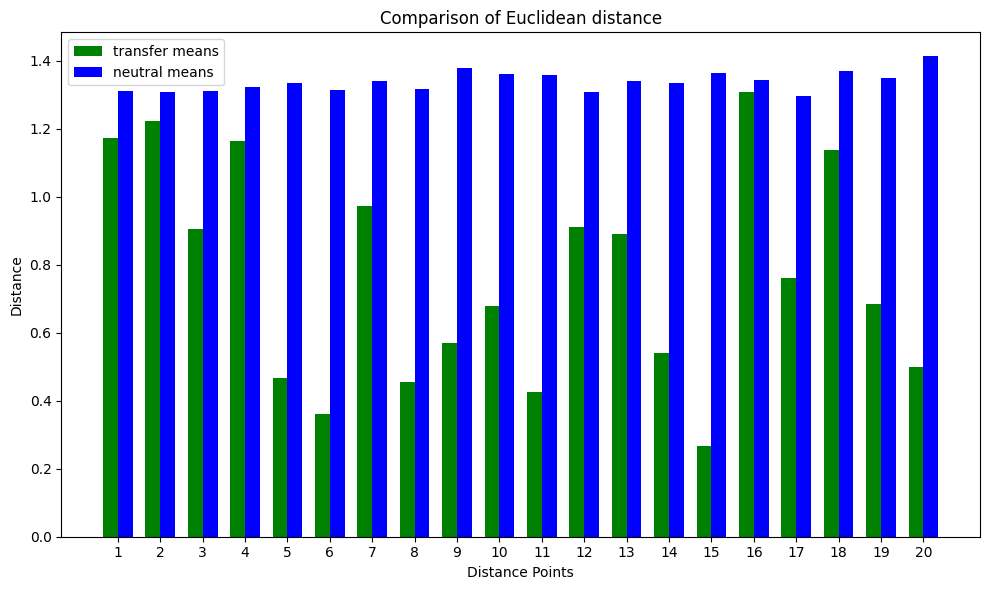

In [15]:
import matplotlib.pyplot as plt
n = len(means)

# Set up the bar positions
index = np.arange(n)
bar_width = 0.35

# Create the bar chart
plt.figure(figsize=(10, 6))
plt.bar(index, means, bar_width, label='transfer means', color="green")
plt.bar(index + bar_width, neutralmeans, bar_width, label='neutral means', color="blue")

# Add labels, title, and legend
plt.xlabel('Distance Points')
plt.ylabel('Distance')
plt.title('Comparison of Euclidean distance')
plt.xticks(index + bar_width / 2, [f'{i+1}' for i in range(n)])
plt.legend()
# Show the plot
plt.tight_layout()
plt.show()

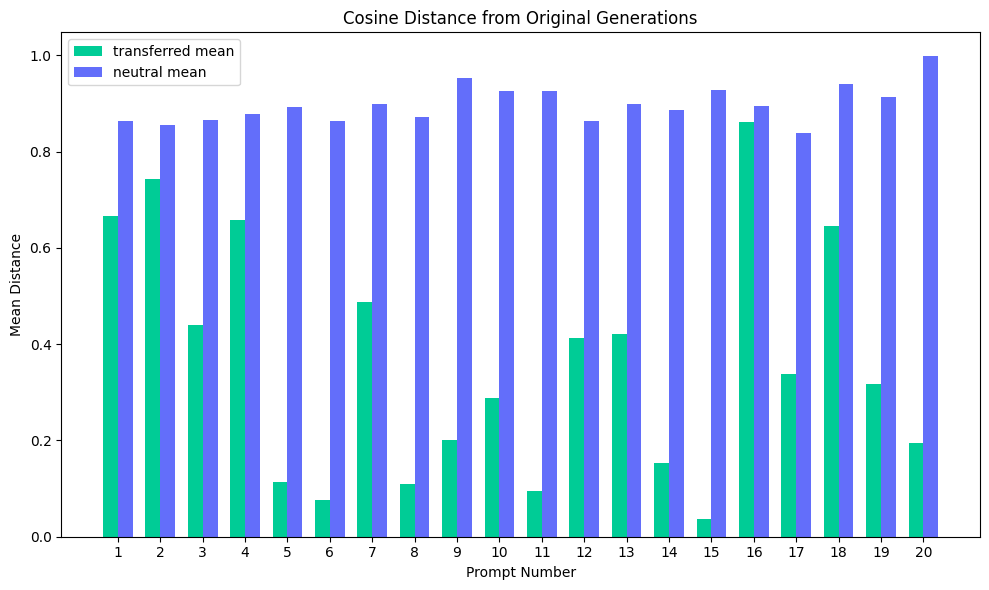

In [16]:
n = len(cosdistmeans)

# Set up the bar positions
index = np.arange(n)
bar_width = 0.35

# Create the bar chart
plt.figure(figsize=(10, 6))
plt.bar(index, cosdistmeans, bar_width, label='transferred mean', color="#00CC96")
plt.bar(index + bar_width, neutralcosdistmeans, bar_width, label='neutral mean', color='#636EFA')

# Add labels, title, and legend
plt.xlabel('Prompt Number')
plt.ylabel('Mean Distance')
plt.title('Cosine Distance from Original Generations')
plt.xticks(index + bar_width / 2, [f'{i+1}' for i in range(n)])
plt.legend()
# Show the plot
plt.tight_layout()
plt.rc('font', size=13)
plt.savefig('cosinedist.png', dpi=600)
plt.show()


In [17]:

from plotly.subplots import make_subplots

types = np.array(['transferred'] * 1000 + ['original'] * 1000 + ['neutral'] * 1000)

# Perform PCA on the entire embeddings dataset
reducer = PCA(n_components=2)
pca_embeddings_reduced = reducer.fit_transform(embeddings)

# Create a subplot layout with 4 rows and 5 columns for 20 plots
fig = make_subplots(rows=4, cols=5, subplot_titles=[f"Group {i+1}" for i in range(20)])

color_map = {
    'neutral': 'blue',
    'original': 'green',
    'transferred': 'red'
}


# Loop through the desired slices to generate PCA plots
for i in range(20):
    # Define slices
    slice_indices = np.r_[i*50:(i+1)*50, 1000 + i*50:1050 + i*50, 2000+i*50:2050+i*50]

    # Select the corresponding PCA-reduced embeddings and types
    pca_slice = pca_embeddings_reduced[slice_indices, :]
    combined_types = types[slice_indices]

    # Create a DataFrame to hold PCA data and the associated metadata
    pca_df = pd.DataFrame(pca_slice, columns=["pcadim1", "pcadim2"])
    pca_df["type"] = combined_types
    pca_df["truncated_output"] = total_df["output"].str.slice(0, 100).iloc[slice_indices].values

    # Determine row and column for the subplot
    row = i // 5 + 1
    col = i % 5 + 1

    # Add the scatter plot to the appropriate subplot, color-coded by type
    for t in pca_df["type"].unique():
        type_data = pca_df[pca_df["type"] == t]
        fig.add_trace(
            go.Scatter(
                x=type_data["pcadim1"],
                y=type_data["pcadim2"],
                mode='markers',
                name=t,
                marker=dict(color=color_map[t]),
                customdata=type_data[["type", "truncated_output"]],
                hovertemplate="<br>".join(
                    ["Type: %{customdata[0]}", "Output: %{customdata[1]}"]
                ),
                showlegend=i == 0,
            ),
            row=row,
            col=col
        )

# Update layout to ensure all subplots have titles and the plot is readable
fig.update_layout(
    height=1200, width=2000,
    title_text="PCA of Story Embeddings Across Multiple Slices",
    showlegend=True
)

# Show the plot
fig.show()



In [18]:


# Example types array corresponding to the embedding dataset
# This should be aligned with the total dataset of embeddings.
types = np.array(['transferred'] * 1000 + ['original'] * 1000 + ['neutral'] * 1000)

# Create a subplot layout with 4 rows and 5 columns for 20 plots
fig = make_subplots(rows=4, cols=5, subplot_titles=[f"Group {i+1}" for i in range(20)])

color_map = {
    'neutral': 'blue',
    'original': 'green',
    'transferred': 'red'
}


# Loop through the desired slices to generate PCA plots
for i in range(20):
    # Define slices
    slice1 = embeddings[i*50:(i+1)*50, :]
    slice2 = embeddings[1000 + i*50:1050 + i*50, :]
    slice3 = embeddings[2000 + i*50:2050 + i*50, :]

    # Concatenate the slices
    combined_embeddings = np.vstack([slice1, slice2, slice3])

    # Perform PCA
    reducer = PCA(n_components=2)
    pca_embeddings_reduced = reducer.fit_transform(combined_embeddings)

    # Assign corresponding types (now 150 elements)
    combined_types = np.concatenate([
        types[i*50:(i+1)*50],            # 50 elements from the first slice
        types[1000 + i*50:1050 + i*50],  # 50 elements from the second slice
        types[2000 + i*50:2050 + i*50]                 # 50 elements from the third slice
    ])

    # Create a DataFrame to hold PCA data and the associated metadata
    pca_df = pd.DataFrame(pca_embeddings_reduced, columns=["pcadim1", "pcadim2"])
    pca_df["type"] = combined_types
    pca_df["truncated_output"] = total_df["output"].str.slice(0, 100)[np.r_[i*50:(i+1)*50, 1000 + i*50:1050 + i*50, 2000:2050]].values

    # Determine row and column for the subplot
    row = i // 5 + 1
    col = i % 5 + 1

    # Add the scatter plot to the appropriate subplot, color-coded by type
    for t in pca_df["type"].unique():
        type_data = pca_df[pca_df["type"] == t]
        fig.add_trace(
            go.Scatter(
                x=type_data["pcadim1"],
                y=type_data["pcadim2"],
                mode='markers',
                name=t,
                marker=dict(color=color_map[t]),
                customdata=type_data[["type", "truncated_output"]],
                hovertemplate="<br>".join(
                    ["Type: %{customdata[0]}", "Output: %{customdata[1]}"]
                ),
                showlegend=i == 0,
            ),
            row=row,
            col=col
        )

# Update layout to ensure all subplots have titles and the plot is readable
fig.update_layout(
    height=1200, width=2000,
    title_text="PCA of Story Embeddings Across Multiple Slices",
    showlegend=True
)

# Show the plot
fig.show()

## Make violin plots


/tmp/ipykernel_3650193/3400672527.py:27: FutureWarning:



The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.



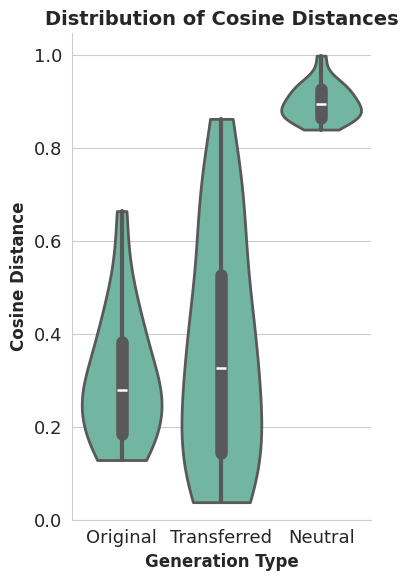

Cosine Distance:
Original: Mean = 0.306, Std = 0.136
Transferred: Mean = 0.363, Std = 0.242
Neutral: Mean = 0.898, Std = 0.038


In [28]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import torch
import numpy as np

# Calculate within-original text distances
orig_cosdist_means = []

for i in range(20):
    # TODO: make sure this is correct
    cos = torch.nn.CosineSimilarity(dim=1)
    orig_cossim = cos(orig_embed[i].unsqueeze(1), orig_embed[i].unsqueeze(0))
    orig_cosdist_means.append(1 - torch.mean(orig_cossim).item())

# Prepare the data
data = pd.DataFrame({
    'Cosine Distance': orig_cosdist_means + cosdistmeans + neutralcosdistmeans,
    'Type': ['Original'] * len(orig_cosdist_means) + ['Transferred'] * len(cosdistmeans) + ['Neutral'] * len(neutralcosdistmeans)
})

# Set up the plot style
plt.figure(figsize=(8, 6))
sns.set_style("whitegrid")
# sns.set_palette("Set2")

# Create the plot
ax = sns.violinplot(x='Type', y='Cosine Distance', data=data, inner="box", cut=0,
                    linewidth=2, width=0.8, scale="width", order=['Original', 'Transferred', 'Neutral'])

# Customize the plot
plt.title('Distribution of Cosine Distances', fontsize=14, fontweight='bold')
plt.xlabel('Generation Type', fontsize=12, fontweight='bold')
plt.ylabel('Cosine Distance', fontsize=12, fontweight='bold')
plt.ylim(0, None)

# Remove top and right spines
sns.despine()

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

# Print summary statistics
print("Cosine Distance:")
print(f"Original: Mean = {np.mean(orig_cosdist_means):.3f}, Std = {np.std(orig_cosdist_means):.3f}")
print(f"Transferred: Mean = {np.mean(cosdistmeans):.3f}, Std = {np.std(cosdistmeans):.3f}")
print(f"Neutral: Mean = {np.mean(neutralcosdistmeans):.3f}, Std = {np.std(neutralcosdistmeans):.3f}")